In [216]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import numpy as np
import struct
import sys
from array import array
import itertools
import os
import sys
from scipy import signal
from scipy.optimize import curve_fit
import subprocess
import shutil
import pandas as pd
pi = np.pi
clight = 299792458

In [225]:
working_folder = 'bench/CEPC_Z_dipole_0_to_1/'
home0 = os.getcwd()
home1 = os.path.join(home0,working_folder)
cwd = working_folder#os.path.join(home0,working_folder)


In [226]:
resultfn = 'ImOmega13550.txt'
resultfn = os.path.join(cwd,resultfn)
data = pd.read_csv(resultfn)
data= data.dropna(axis=1)
haxis = np.sort([float(i) for i in data.columns])
#haxis2 = np.sort([float(i) for i in data.columns.levels[1][:-1]])

In [227]:
resultfn = 'ReOmega13550.txt'
resultfn = os.path.join(cwd,resultfn)
dataRe = pd.read_csv(resultfn)
dataRe= dataRe.dropna(axis=1)

In [228]:
haxis

array([-25000., -24870., -24740., -24610., -24480., -24350., -24220.,
       -24090., -23960., -23830., -23700., -23570., -23440., -23310.,
       -23180., -23050., -22920., -22790., -22660., -22530., -22400.,
       -22270., -22140., -22010., -21880., -21750., -21620., -21490.,
       -21360., -21230., -21100., -20970., -20840., -20710., -20580.,
       -20450., -20320., -20190., -20060., -19930., -19800., -19670.,
       -19540., -19410., -19280., -19150., -19020., -18890., -18760.,
       -18630., -18500., -18370., -18240., -18110., -17980., -17850.,
       -17720., -17590., -17460., -17330., -17200., -17070., -16940.,
       -16810., -16680., -16550., -16420., -16290., -16160., -16030.,
       -15900., -15770., -15640., -15510., -15380., -15250., -15120.,
       -14990., -14860., -14730., -14600., -14470., -14340., -14210.,
       -14080., -13950., -13820., -13690., -13560., -13430., -13300.,
       -13170., -13040., -12910., -12780., -12650., -12520., -12390.,
       -12260., -121

<ipython-input-229-70e478461e7d>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1,axes1 = plt.subplots(1,1)


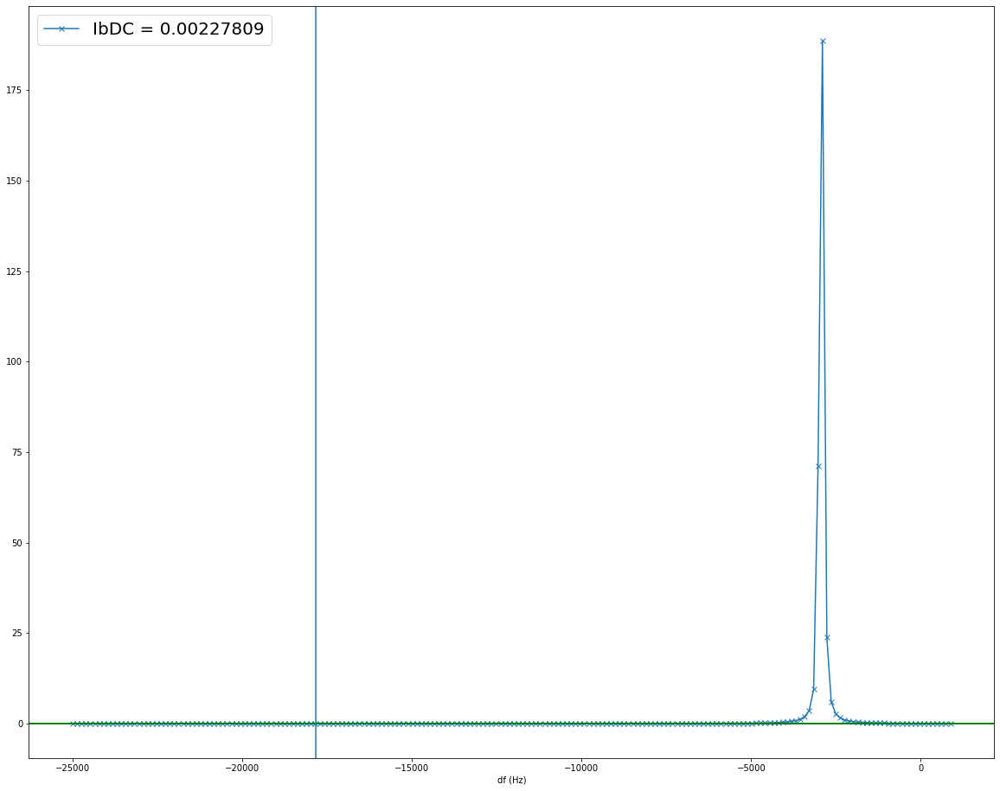

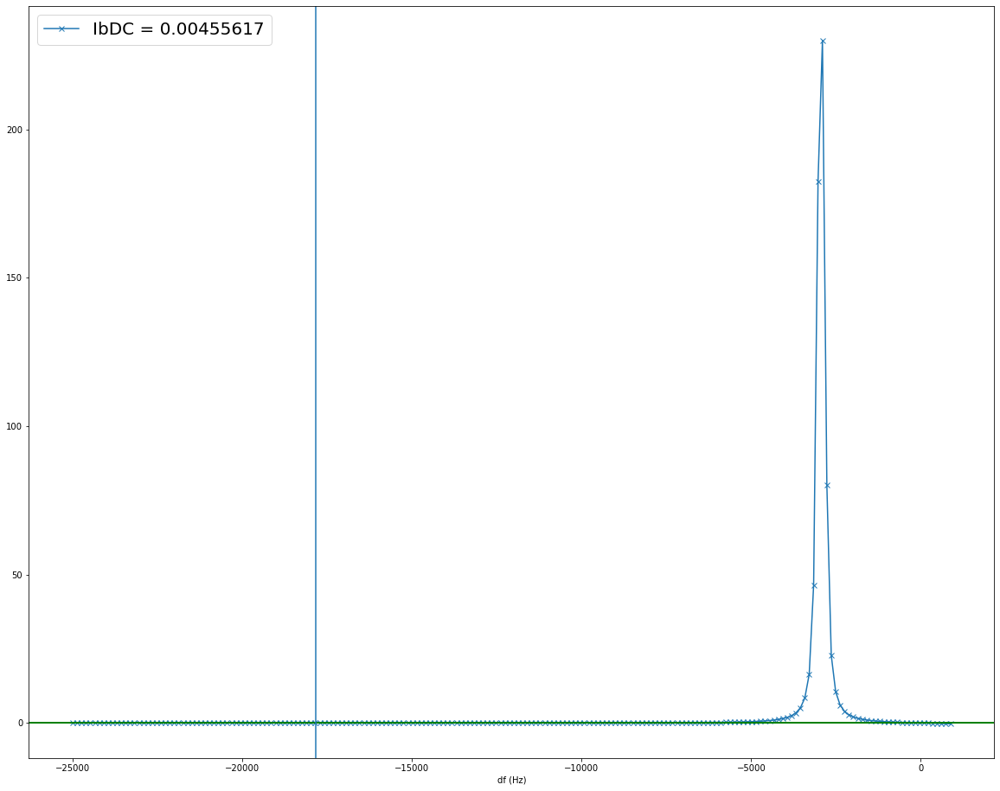

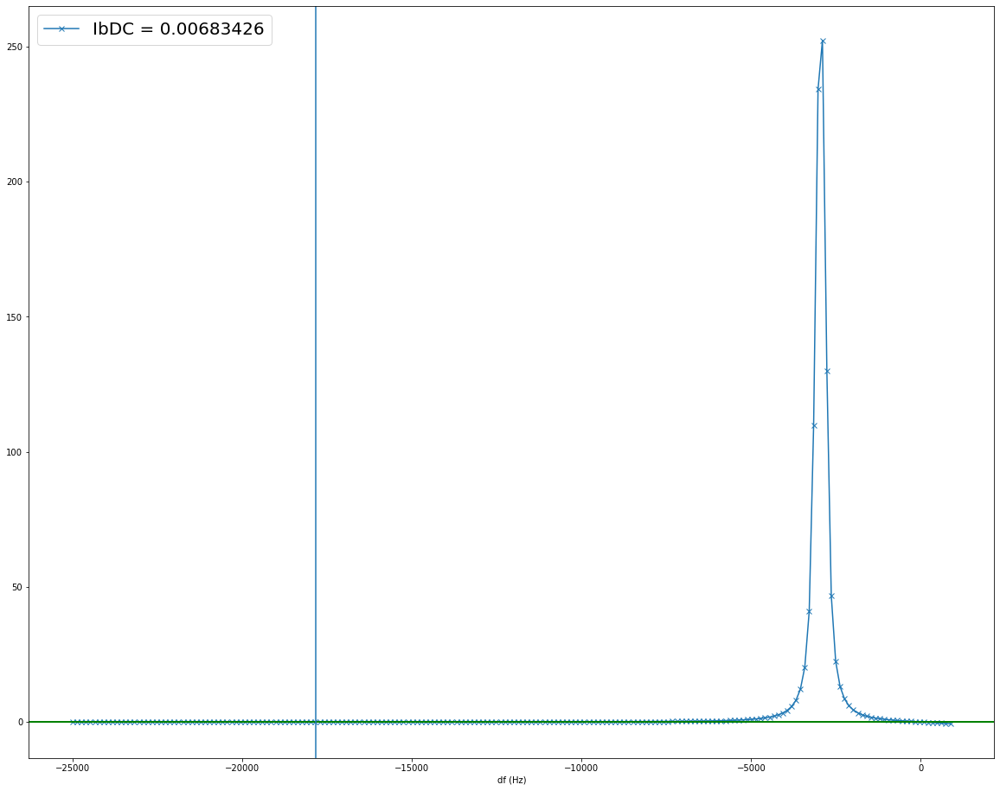

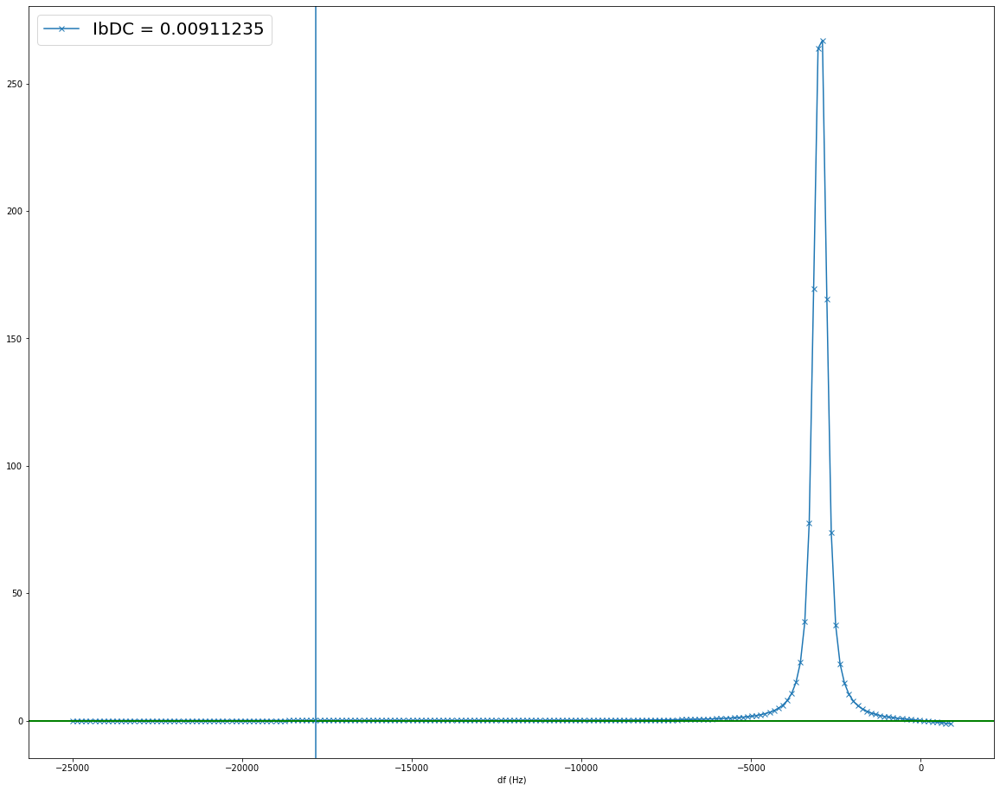

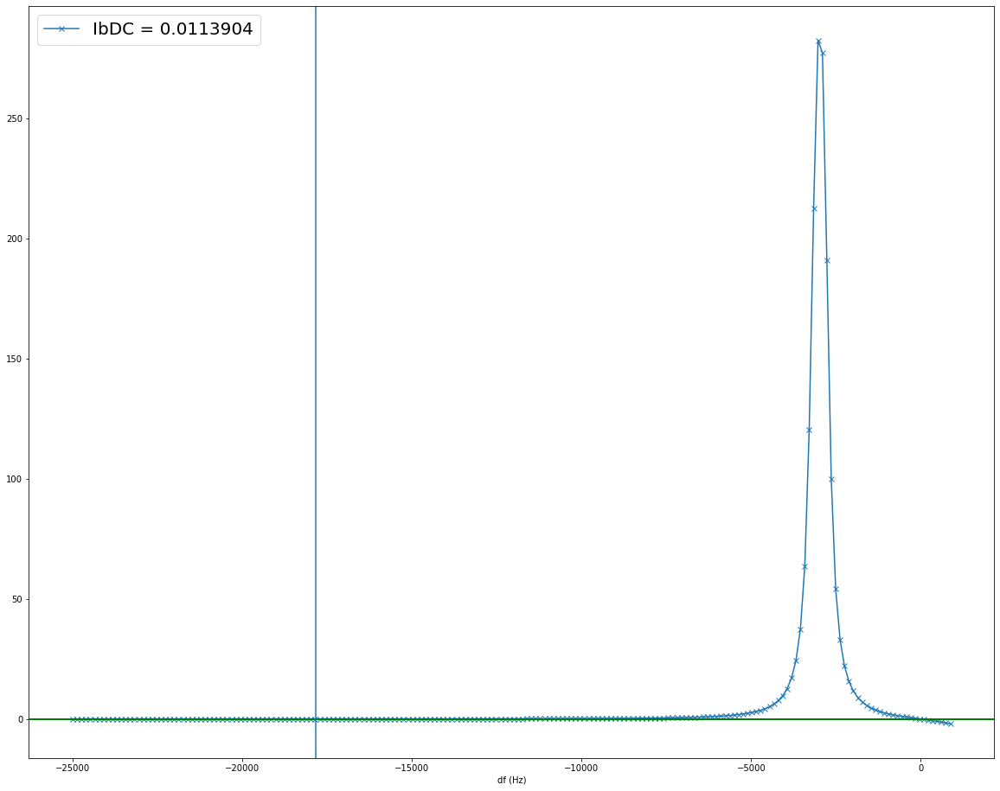

...

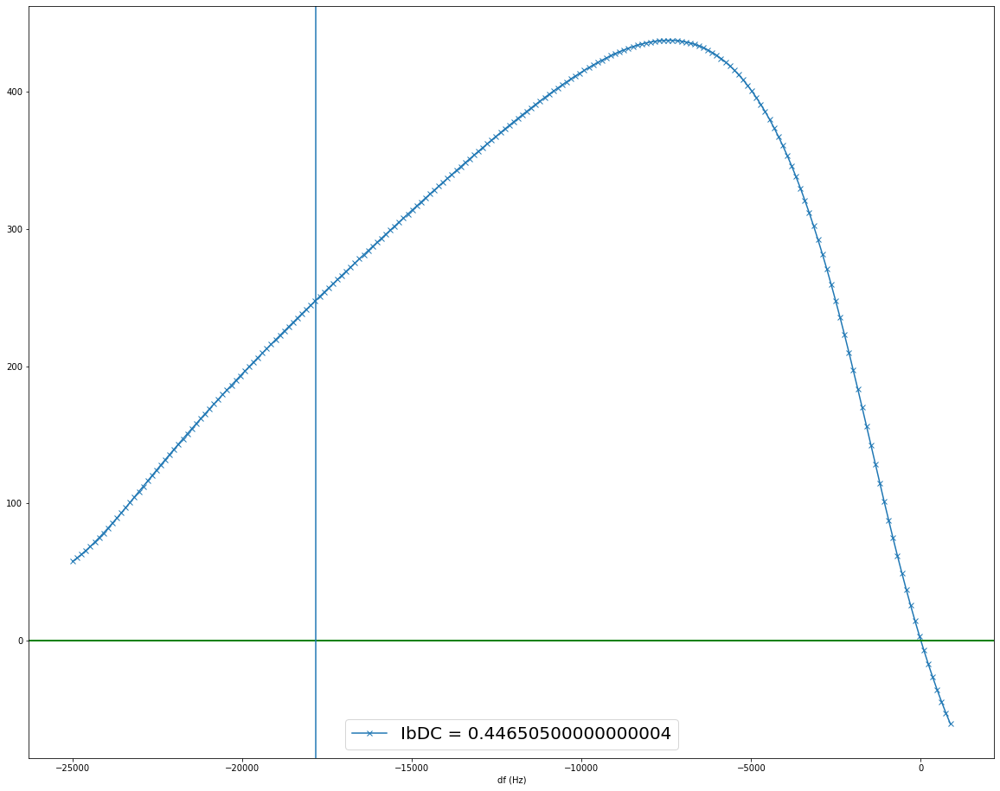

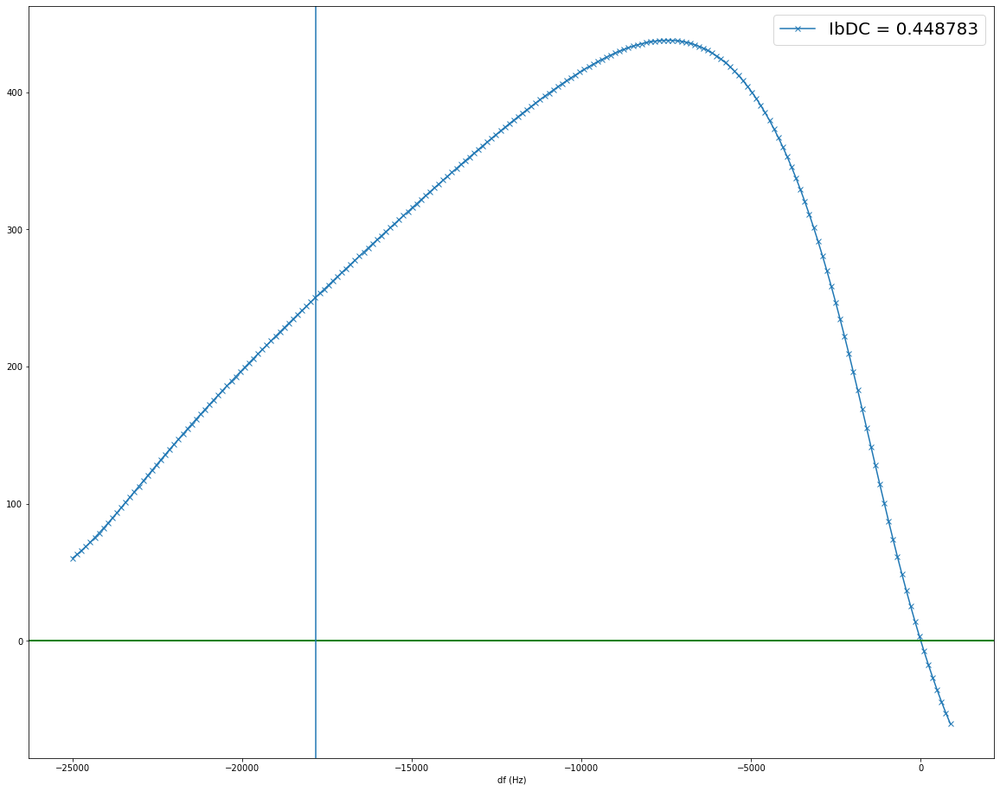

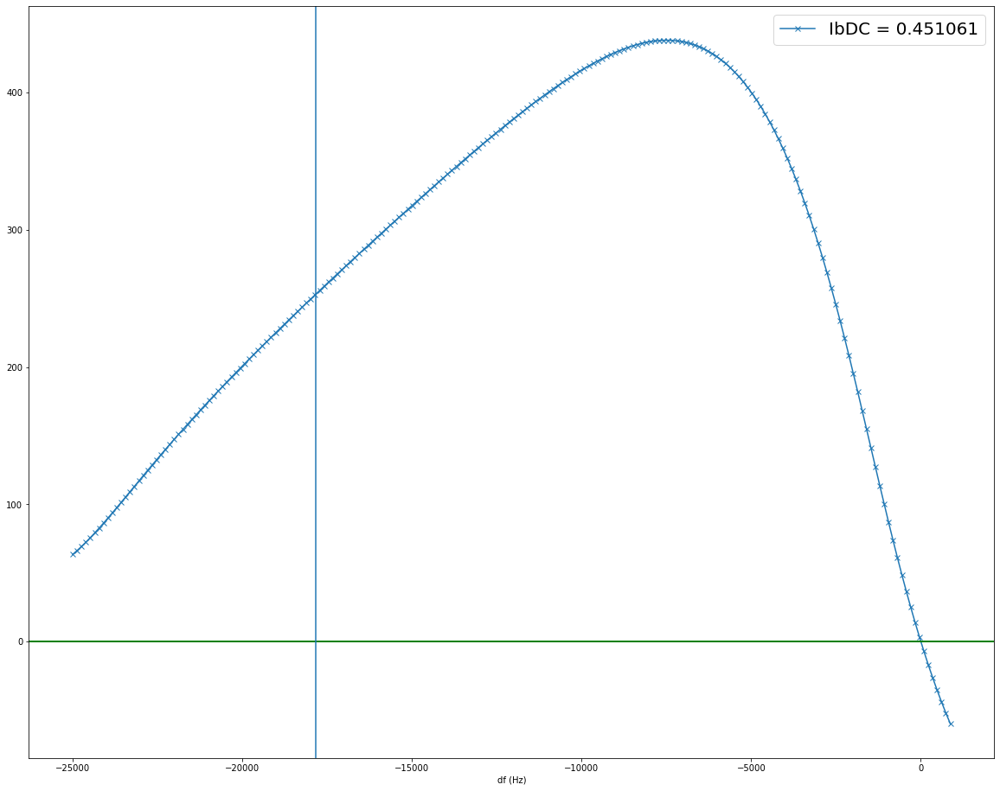

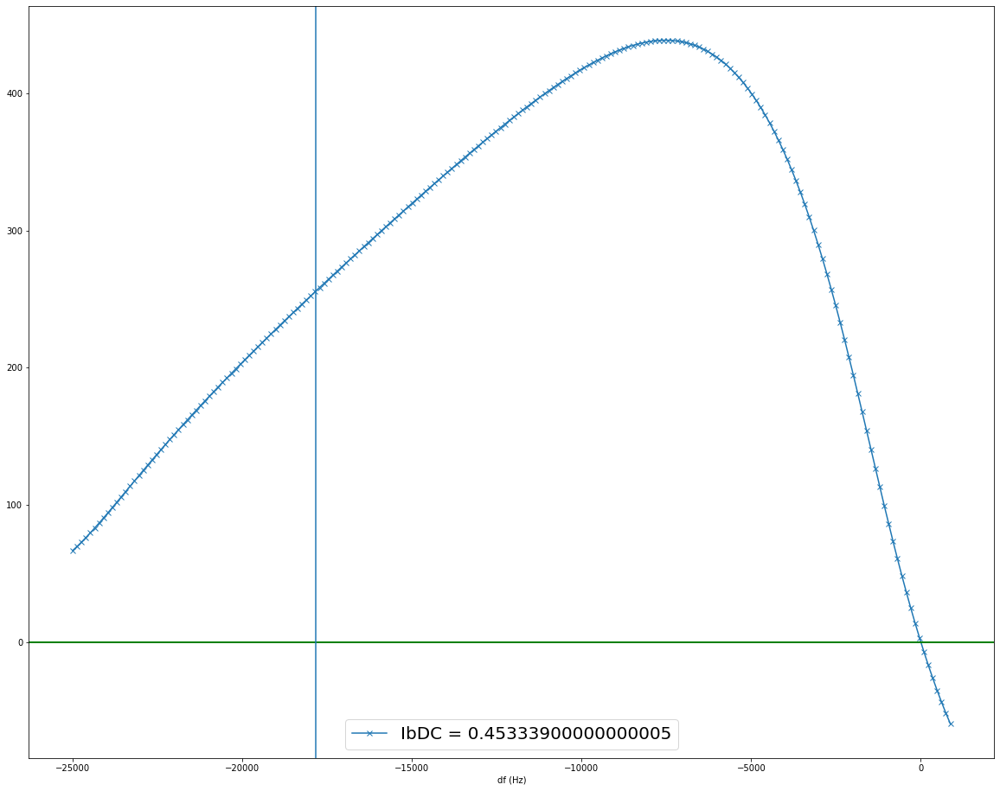

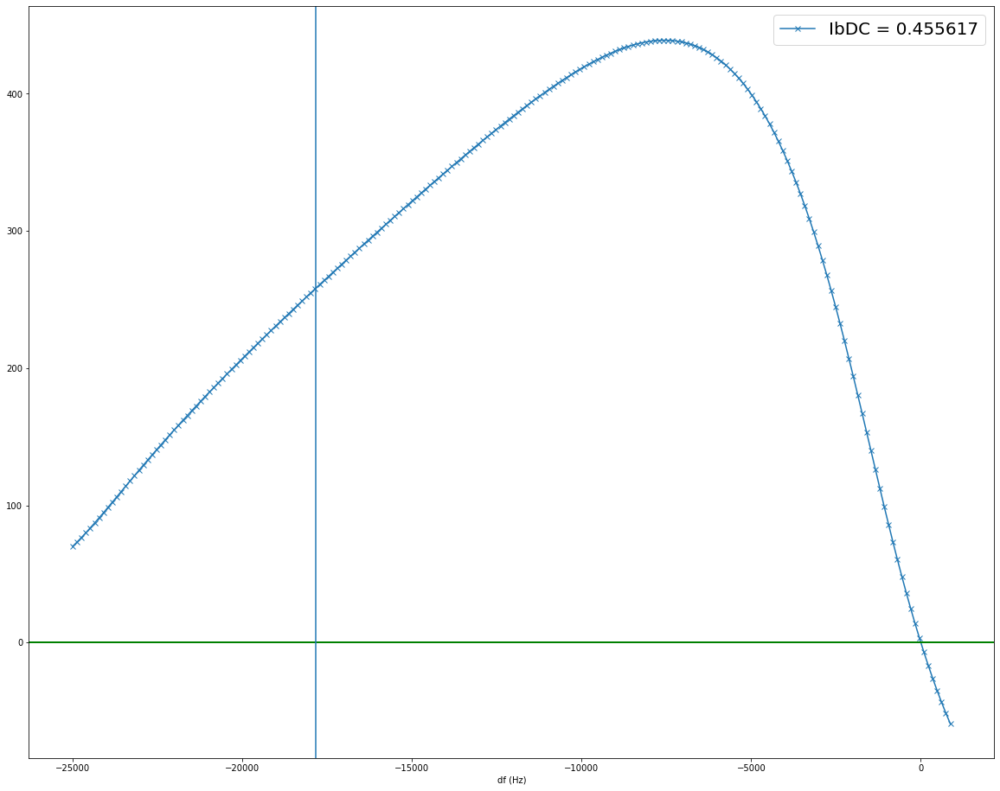

In [229]:
for i in data.index:
    fig1,axes1 = plt.subplots(1,1)
    axes1.plot(haxis,data.loc[i],'x-')
    axes1.axhline(y = 0,linewidth = 2,color='g')
    axes1.axvline(x = -17837.372266)
    axes1.set_xlabel("df (Hz)")
    axes1.legend(['IbDC = '+str(i)],fontsize=20)
    fig1.set_figheight(16)
    fig1.set_figwidth(20)
    #fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
    #plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

<ipython-input-230-bc67d8fb742b>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig1,axes1 = plt.subplots(1,1)


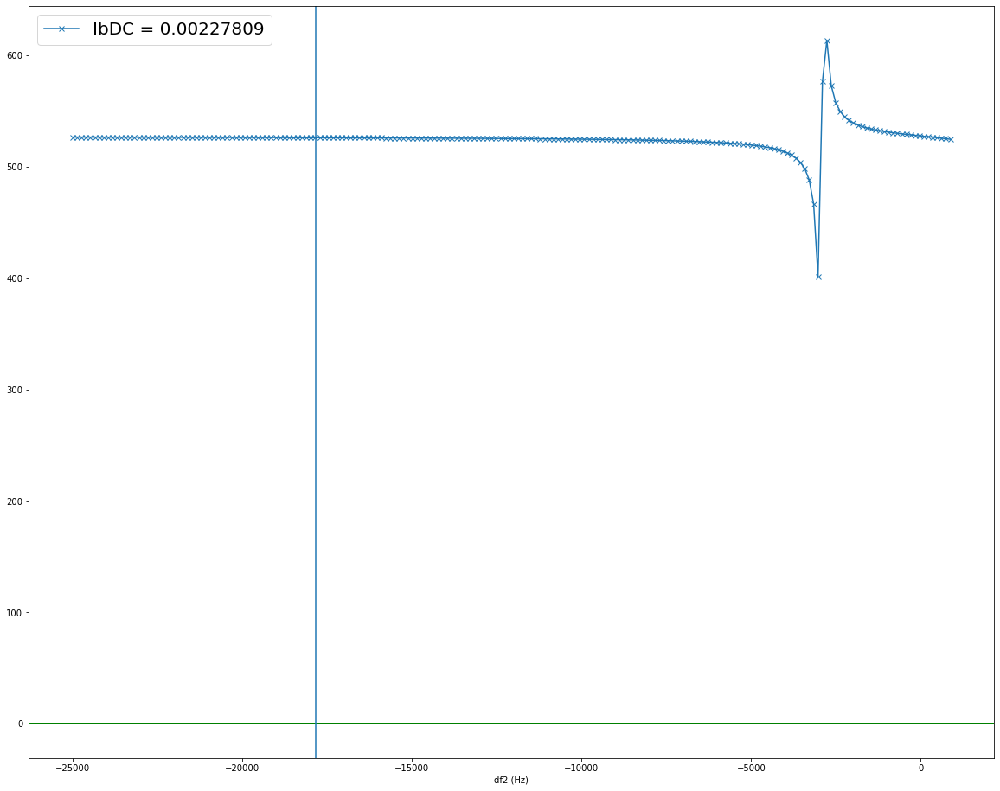

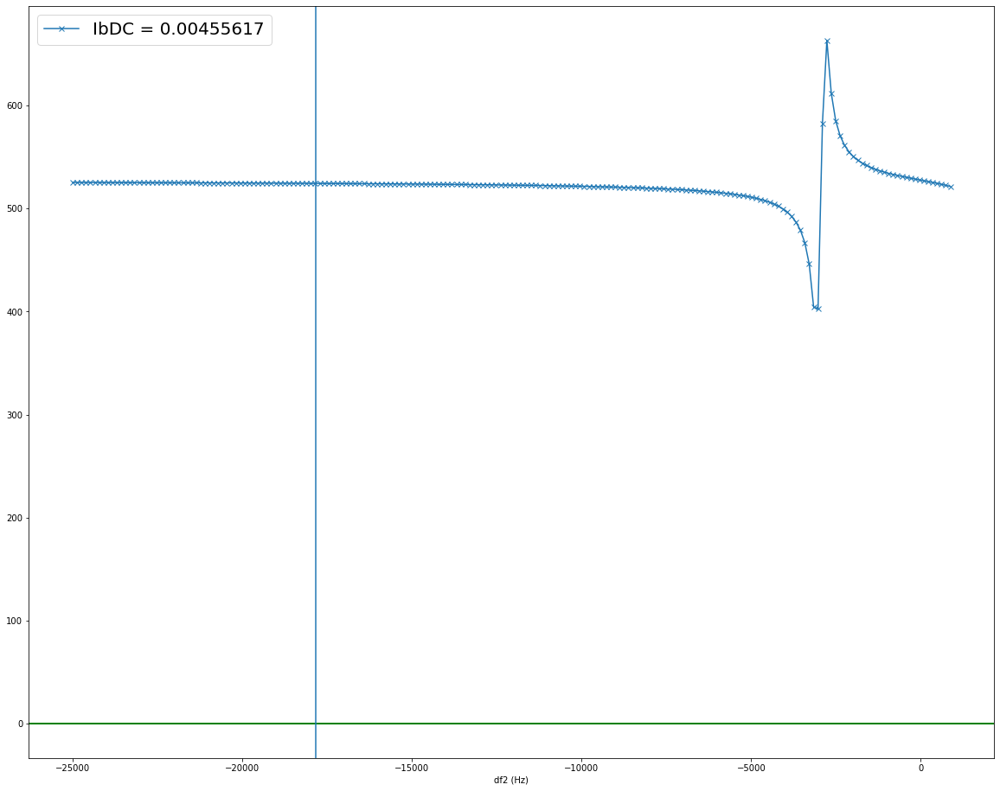

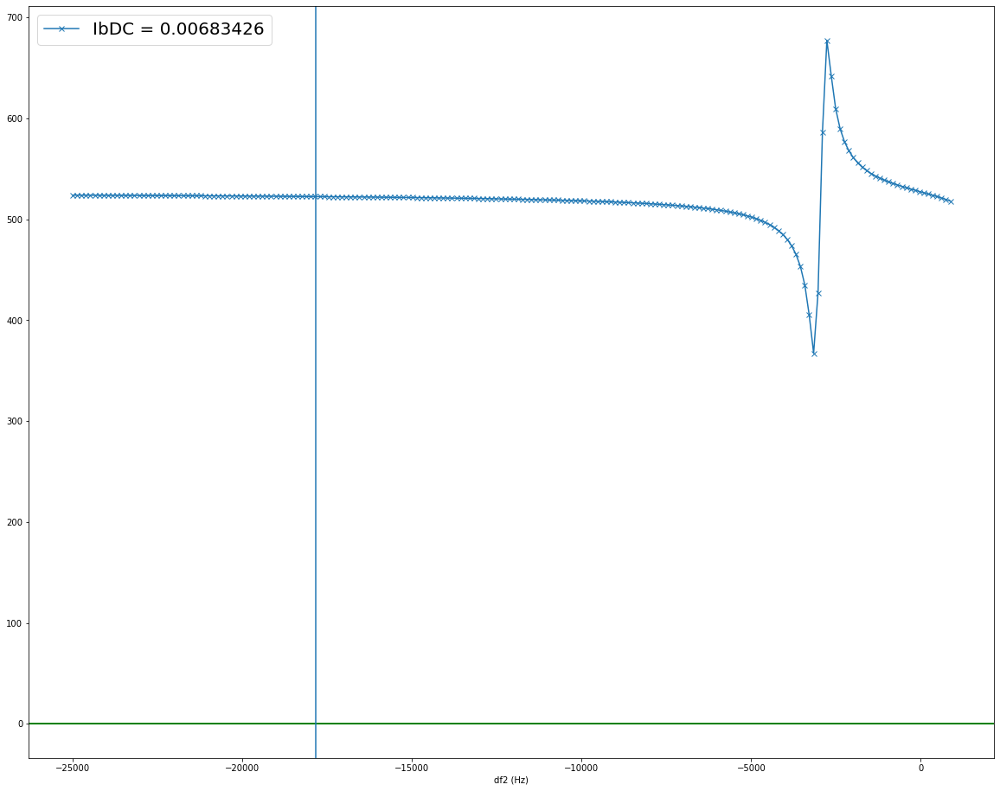

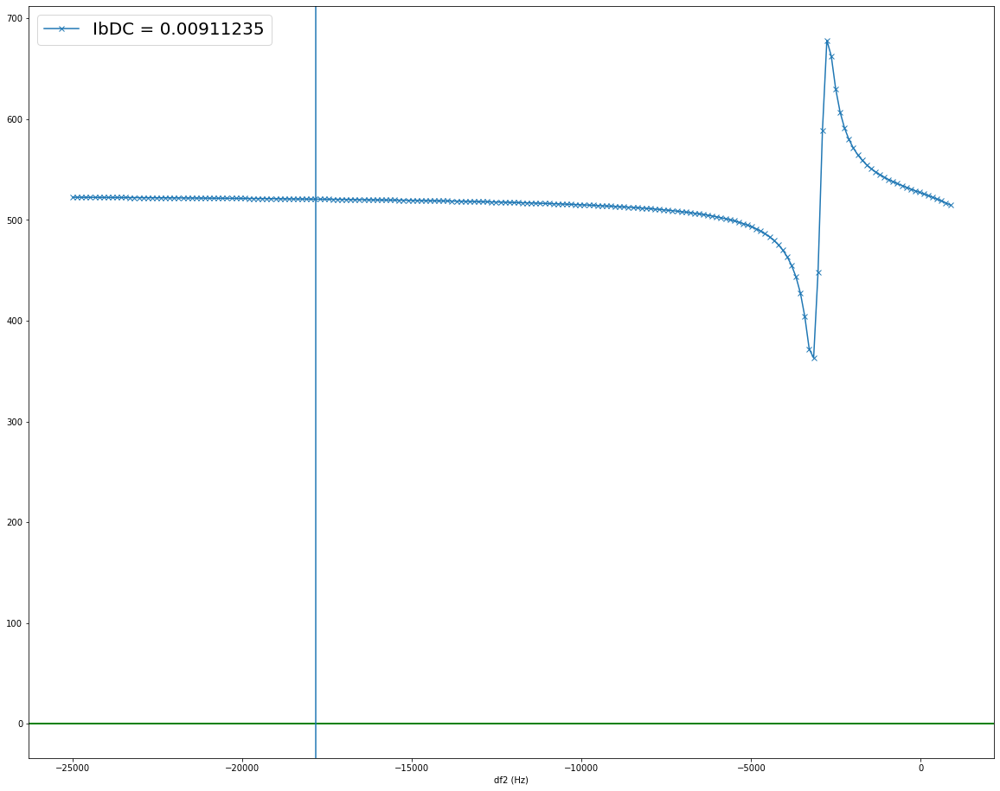

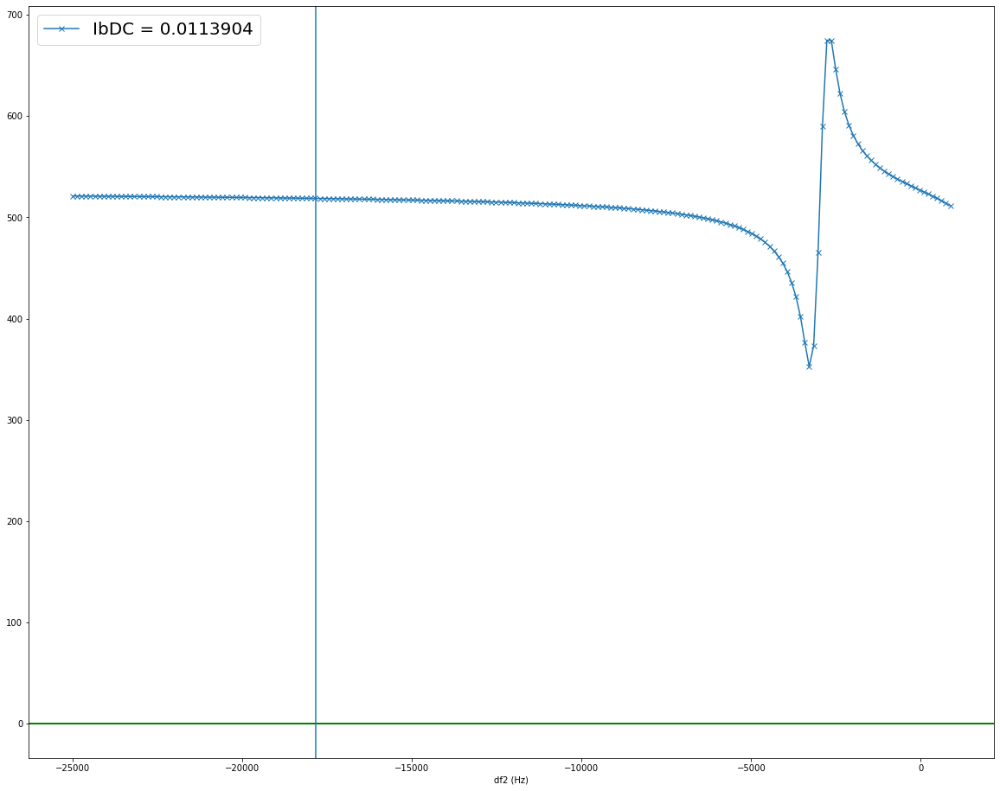

...

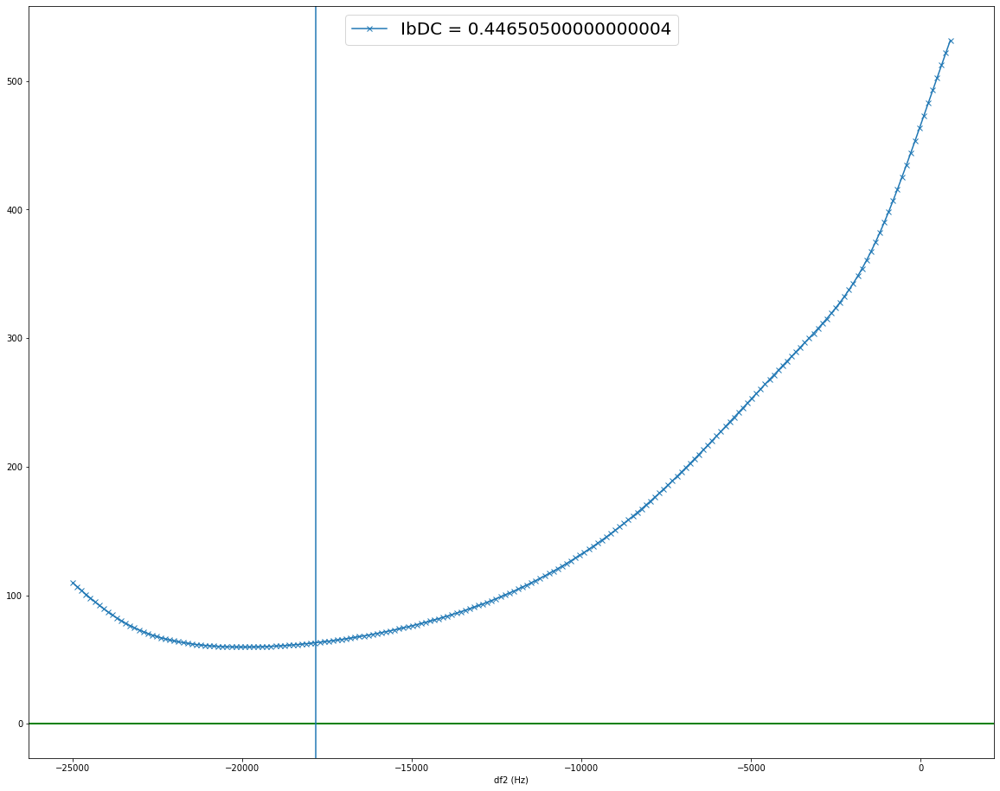

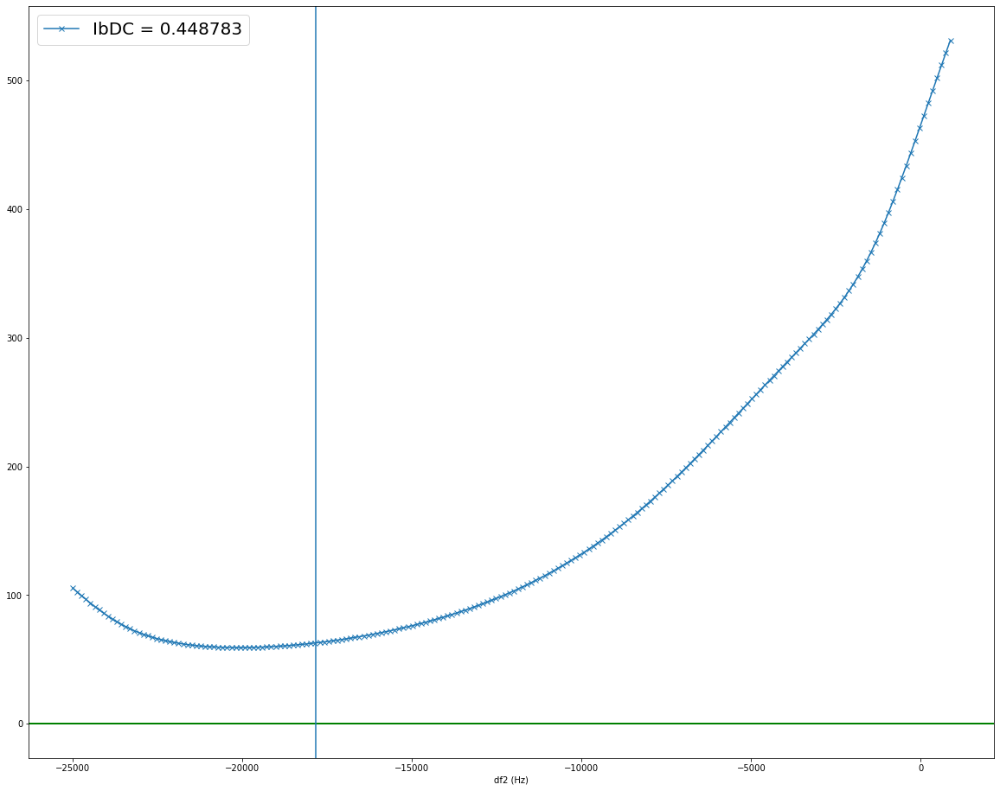

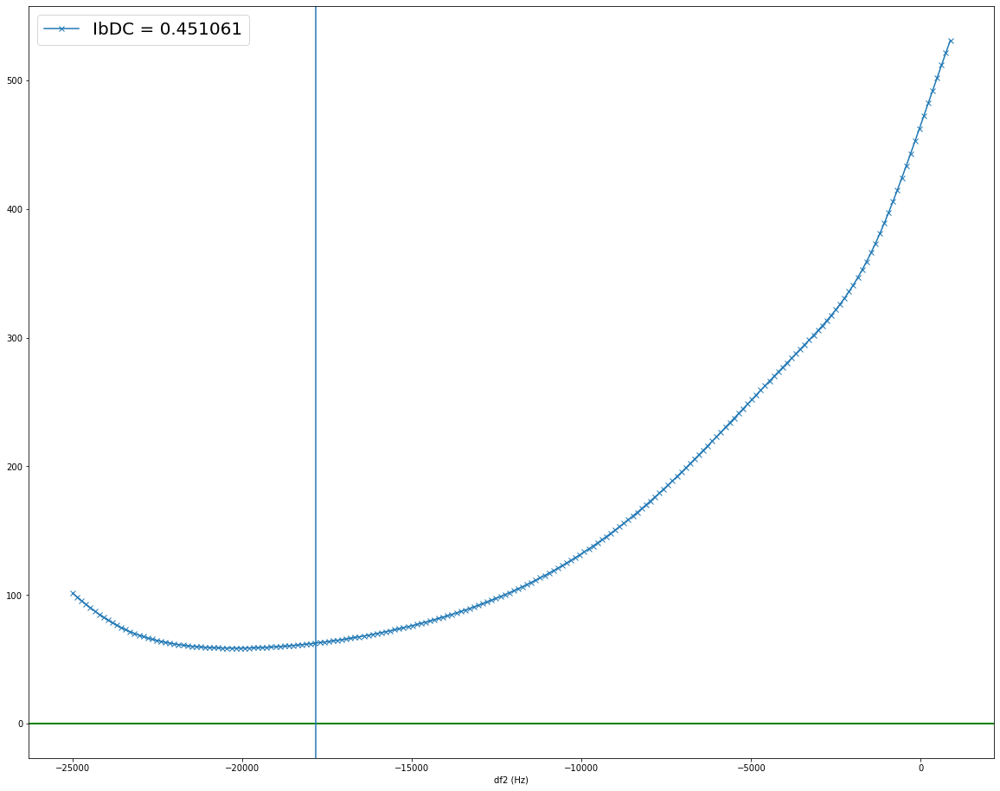

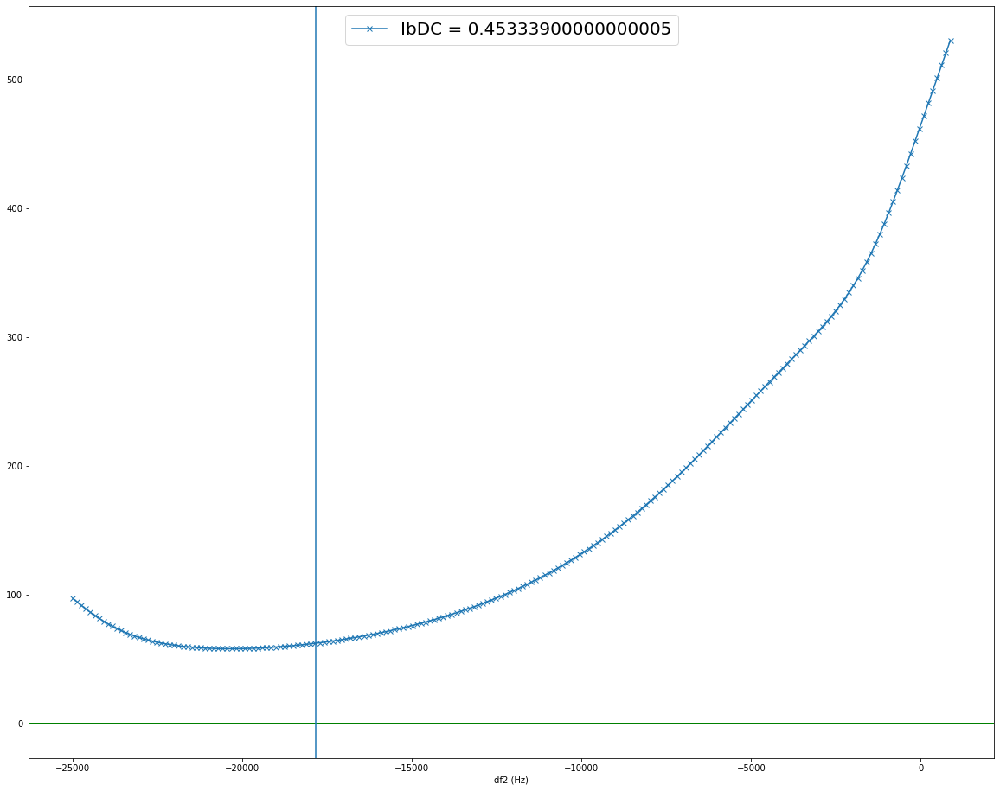

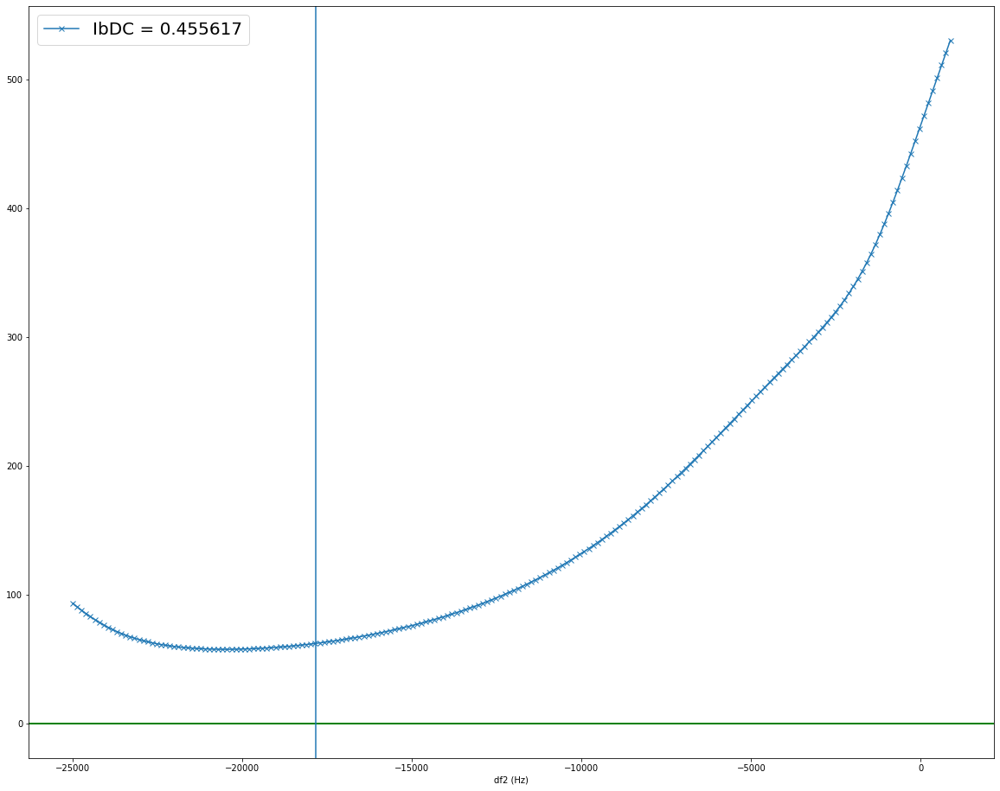

In [230]:
for i in dataRe.index:
    fig1,axes1 = plt.subplots(1,1)
    axes1.plot(haxis,dataRe.loc[i],'x-')
    axes1.axhline(y = 0,linewidth = 2,color='g')
    axes1.axvline(x = -17837.72266)
    axes1.set_xlabel("df2 (Hz)")
    axes1.legend(['IbDC = '+str(i)],fontsize=20)
    fig1.set_figheight(16)
    fig1.set_figwidth(20)

    #fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
    #plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

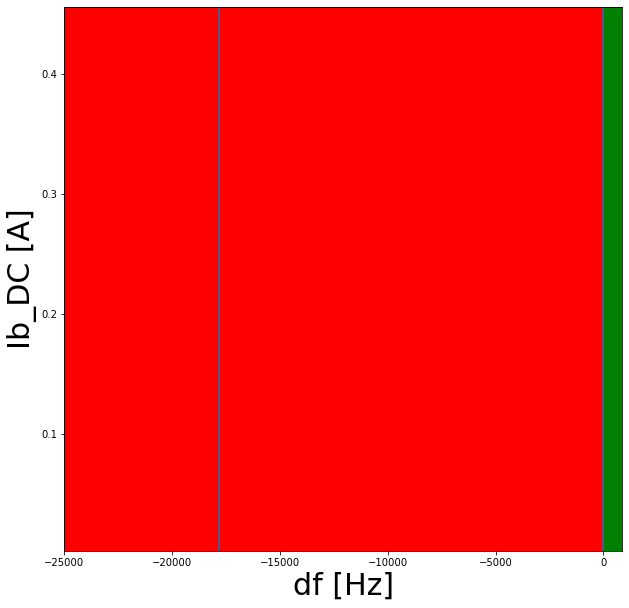

In [231]:
damp = 0
fig1,axes1 = plt.subplots(1,1)
#axes1.contourf(haxis,data.index.values,data.values-damp,levels=[-1e10,0,1e10],colors=['g','r'],antialiased=False)
axes1.contourf(haxis,data.index.values,data.values-damp,levels=[-1e10,0,1e10],colors=['g','r'],antialiased=False)

axes1.axvline(x=0)
axes1.axvline(x=-17837.372266)
fig1.set_figheight(10)
fig1.set_figwidth(10)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

In [11]:
approxresultfn = 'ApproxImOmega0.txt'
approxresultfn = os.path.join(cwd,approxresultfn)
approxdata = pd.read_csv(approxresultfn)
approxdata= approxdata.dropna(axis=1)
haxis = [float(i) for i in approxdata.columns]

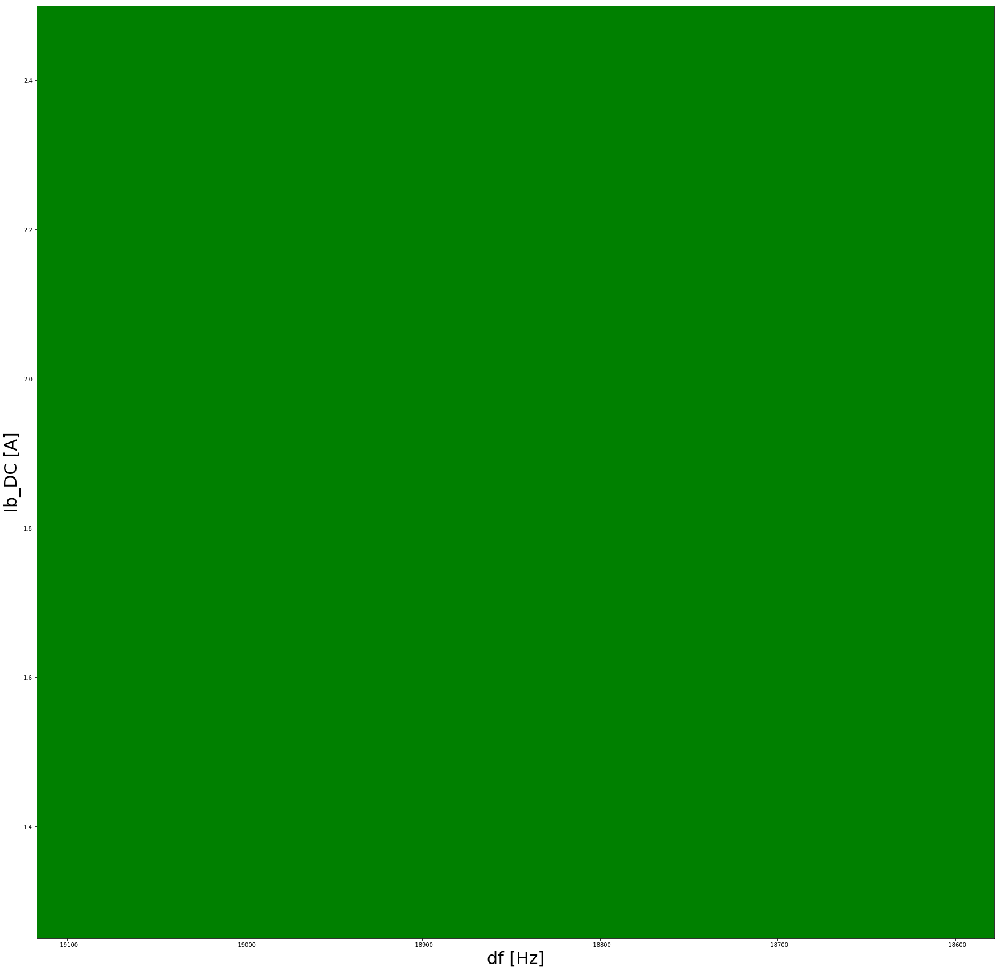

In [12]:
damp = 0
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(haxis,approxdata.index.values,approxdata.values-damp,levels=[-1e10,0,1e10],colors=['g','r'])
#axes1.contour(haxis,approxdata.index.values,approxdata.values-damp,levels=[-1e10,0,1e10])

#axes1.axvline(x = 0,linewidth = 2,color='b')
#axes1.axvline(x = -19900,linewidth = 2,color='y')
#axes1.axvline(x = -22800,linewidth = 2,color='y')
#axes1.axvline(x = -68000,linewidth = 2,color='y')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'approxstability_map_mu_0.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

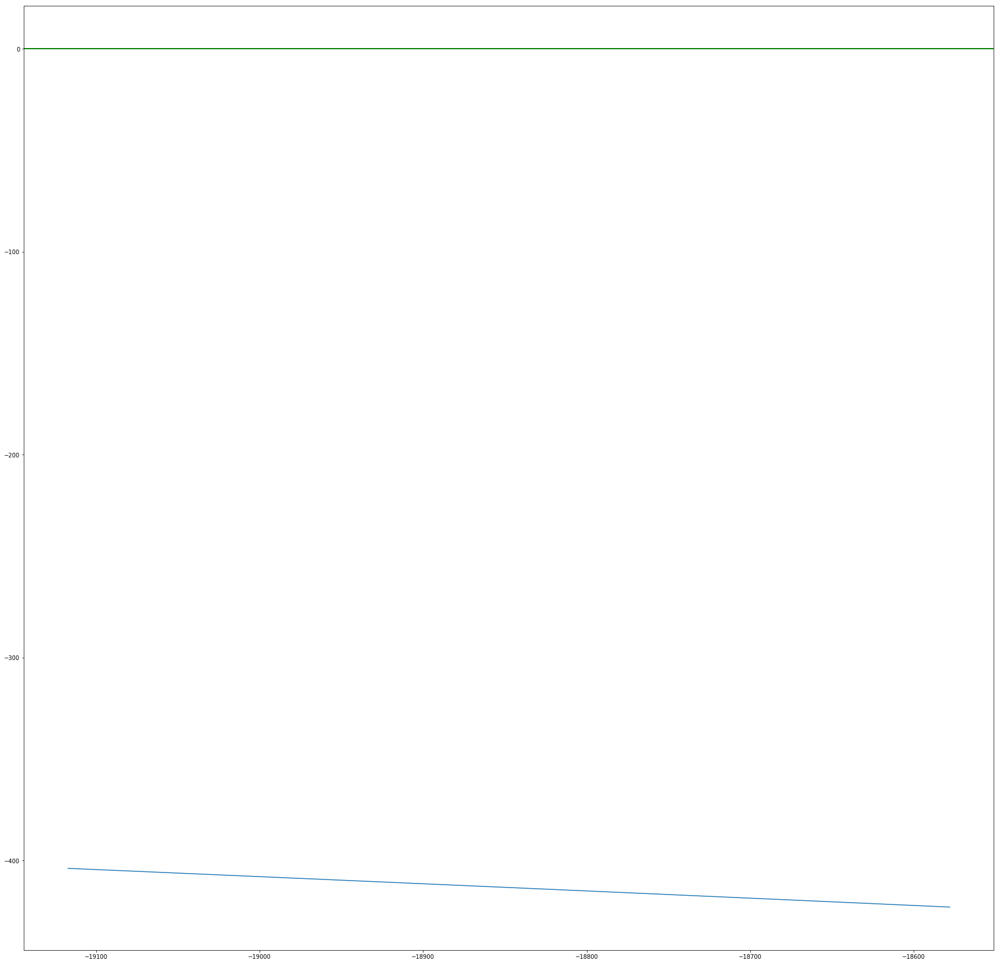

In [15]:
fig1,axes1 = plt.subplots(1,1)
axes1.plot(haxis,approxdata.iloc[0].values)

#axes1.axvline(x = 0,linewidth = 2,color='b')
#axes1.axvline(x = -19900,linewidth = 2,color='y')
#axes1.axvline(x = -20790,linewidth = 2,color='g')
#axes1.axvline(x = -68000,linewidth = 2,color='r')

axes1.axhline(y = 0,linewidth = 2,color='g')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
#axes1.set_ylabel('Ib_DC [A]',fontsize=30)
#axes1.set_xlabel('df [Hz]',fontsize=30)

#fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
#plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

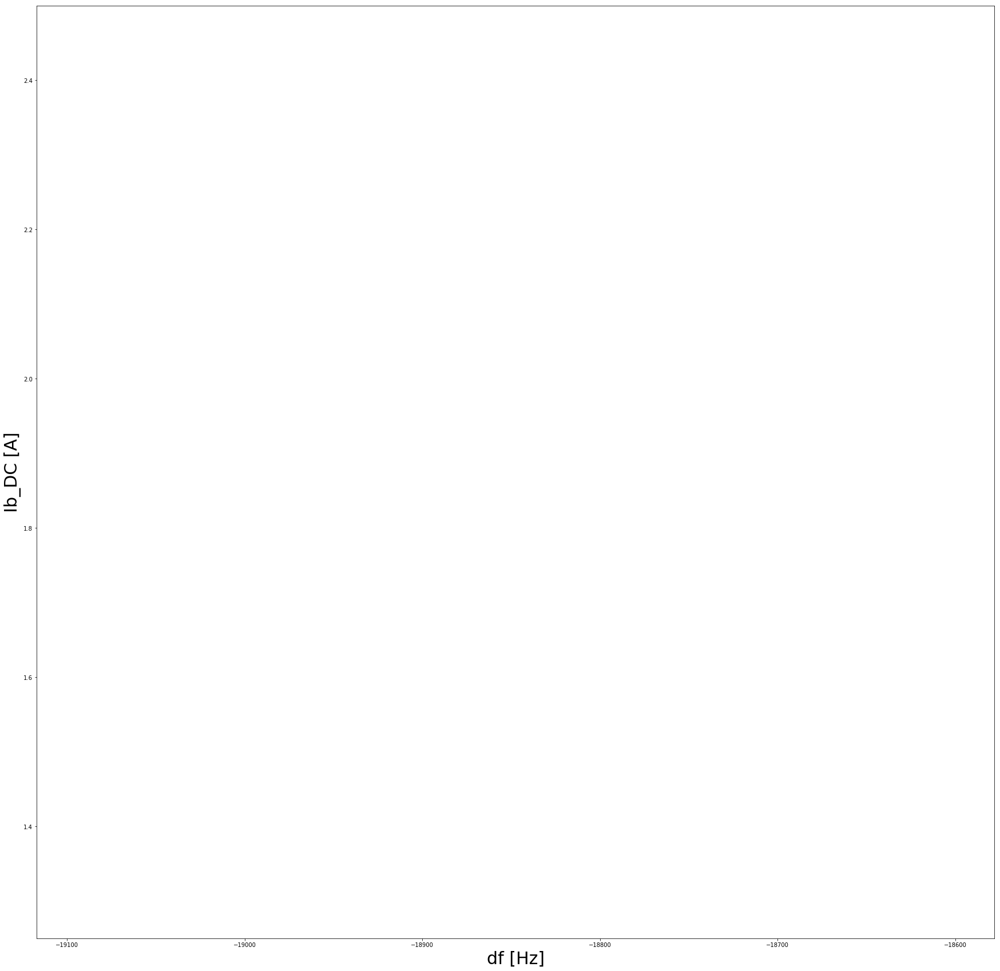

In [14]:
damp = 0
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(haxis,approxdata.index.values,approxdata.values-data.values,levels=[-1e1,0,1e10],colors=['g','r'])
#axes1.contour(haxis,approxdata.index.values,approxdata.values-damp,levels=[-1e10,0,1e10])

#axes1.axvline(x = 0,linewidth = 2,color='b')
#axes1.axvline(x = -19900,linewidth = 2,color='y')
#axes1.axvline(x = -22800,linewidth = 2,color='y')
#axes1.axvline(x = -68000,linewidth = 2,color='y')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'approx_iter_differentce_stability_map_mu_0.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.plot(haxis,data.iloc[0].values-approxdata.iloc[0].values)

axes1.axvline(x = 0,linewidth = 2,color='b')
#axes1.axvline(x = -19900,linewidth = 2,color='y')
#axes1.axvline(x = -20790,linewidth = 2,color='g')
#axes1.axvline(x = -68000,linewidth = 2,color='r')

axes1.axhline(y = 0,linewidth = 2,color='g')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
#axes1.set_ylabel('Ib_DC [A]',fontsize=30)
#axes1.set_xlabel('df [Hz]',fontsize=30)

#fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
#plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

In [ ]:
resultfn = 'ImOmega1259.txt'
resultfn = os.path.join(cwd,resultfn)
data2 = pd.read_csv(resultfn)
data2= data2.dropna(axis=1)
haxis = [float(i) for i in data2.columns]

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(haxis,data2.index.values,data2.values-0,levels=[-1e10,0,1e10],colors=['g','r'])

axes1.axvline(x = 0,linewidth = 2,color='b')
axes1.axvline(x = -19900,linewidth = 2,color='y')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'stability_map_mu_1259.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.plot(haxis,data2.iloc[-1].values-damp)

axes1.axvline(x = 0,linewidth = 2,color='b')
axes1.axvline(x = -19900,linewidth = 2,color='y')
axes1.axvline(x = -20790,linewidth = 2,color='g')
axes1.axhline(y = 0,linewidth = 2,color='g')

#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
#axes1.set_ylabel('Ib_DC [A]',fontsize=30)
#axes1.set_xlabel('df [Hz]',fontsize=30)

#fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
#plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

Debug Zone

In [ ]:
resultfn = 'ImOmega_serial .txt'
resultfn = os.path.join(cwd,resultfn)
data = pd.read_csv(resultfn)


In [ ]:
a= data.dropna(axis=1)

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(a.columns,a.index,a.values,levels=[-1e10,0,1e10],colors=['g','r'])

axes1.axvline(x = len(a.columns)/2.0-0.5,linewidth = 15,color='b')
#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(120)
fig1.set_figwidth(120)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()


In [ ]:
resultfn = 'ImOmega_para.txt'
resultfn = os.path.join(cwd,resultfn)
datapara = pd.read_csv(resultfn)
a= datapara.dropna(axis=1)

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(a.columns,a.index,a.values,levels=[-1e10,0,1e10],colors=['g','r'])

axes1.axvline(x = len(a.columns)/2.0-0.5,linewidth = 15,color='b')
#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(60)
fig1.set_figwidth(60)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
plt.savefig(fn_stab,bbox_inches='tight')
plt.show()


In [ ]:
resultfn = 'ImOmega_para2.txt'
resultfn = os.path.join(cwd,resultfn)
datapara = pd.read_csv(resultfn)
c= datapara.dropna(axis=1)

In [ ]:
fig1,axes1 = plt.subplots(1,1)
axes1.contourf(c.columns,c.index,c.values-0,levels=[-1e2,0,1e10],colors=['g','r'])

axes1.axvline(x = len(c.columns)/2.0-0.5,linewidth = 2,color='b')
#axes1.axvline(x = detune_final,linewidth = 5,color='b')

fig1.set_figheight(30)
fig1.set_figwidth(30)
axes1.set_ylabel('Ib_DC [A]',fontsize=30)
axes1.set_xlabel('df [Hz]',fontsize=30)

#fn_stab = os.path.join(cwd,'stability_map_mu_0.jpg')
#plt.savefig(fn_stab,bbox_inches='tight')
plt.show()

In [ ]:
Vc = 23.7e6
RoQ = 73*14
QL = 3e4
R = RoQ*QL
Ib = 2.7*2/6
I0 = Vc/R
Y = Ib/I0
print("R = ",R/1e6/14)
print("Y = ",Y)

In [123]:
0.06/12e-6

5000.0